In [13]:
#TODO: extend to multiple variables 

# Imports
import pickle
import cartopy
import matplotlib.pyplot as plt
import matplotlib.colors as clr
import numpy as np
import iris
from iris.analysis import Aggregator
import iris.plot as iplt
import iris.quickplot as qplt
import iris.coord_categorisation
from iris.util import rolling_window
from ruamel import yaml
from tqdm import tqdm
from ruamel.yaml import ruamel
import warnings

import os

In [14]:
# set outputpath for plots etc

outputdir = '/p/tmp/quante/snow_simulation_data/notebook_output'
os.chdir(outputdir)

In [129]:
# load results data from nc data probing:

filelist = [
'/p/tmp/quante/snow_simulation_data/notebook_output/ukesm1-0-llpreindustrial_NORTHERN EUROPE20200408_15:37:15',
'/p/tmp/quante/snow_simulation_data/notebook_output/ukesm1-0-llpreindustrial_NORTHERN AMERICA20200408_15:15:39',
'/p/tmp/quante/snow_simulation_data/notebook_output/mri-esm2-0preindustrial_NORTHERN EUROPE20200408_14:47:11',
'/p/tmp/quante/snow_simulation_data/notebook_output/mri-esm2-0preindustrial_NORTHERN AMERICA20200408_14:26:24',
'/p/tmp/quante/snow_simulation_data/notebook_output/mpi-esm1-2-hrpreindustrial_NORTHERN EUROPE20200408_13:57:48',
'/p/tmp/quante/snow_simulation_data/notebook_output/mpi-esm1-2-hrpreindustrial_NORTHERN AMERICA20200408_13:36:58',
'/p/tmp/quante/snow_simulation_data/notebook_output/ipsl-cm6a-lrpreindustrial_NORTHERN EUROPE20200408_13:08:43',
'/p/tmp/quante/snow_simulation_data/notebook_output/ipsl-cm6a-lrpreindustrial_NORTHERN AMERICA20200408_12:46:59',
'/p/tmp/quante/snow_simulation_data/notebook_output/gfdl-esm4preindustrial_NORTHERN EUROPE20200408_12:18:29',
'/p/tmp/quante/snow_simulation_data/notebook_output/gfdl-esm4preindustrial_NORTHERN AMERICA20200408_11:57:12'
]


results = []
for i_file in filelist:
    with open(i_file, 'rb') as stream:
        results.append(pickle.load(stream))

number_models=len(results)


In [16]:
print(results[1])

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


In [130]:
print(results[1][('mpi-esm1-2-hr','preindustrial', 'NORTHERN AMERICA')].keys())

dict_keys([('historical', 1851, 1860), ('historical', 1861, 1870), ('historical', 1871, 1880), ('historical', 1881, 1890), ('historical', 1891, 1900), ('historical', 1901, 1910), ('historical', 1911, 1920), ('historical', 1921, 1930), ('ssp126', 2021, 2030), ('ssp370', 2021, 2030), ('ssp585', 2021, 2030), ('ssp126', 2031, 2040), ('ssp370', 2031, 2040), ('ssp585', 2031, 2040), ('ssp126', 2041, 2050), ('ssp370', 2041, 2050), ('ssp585', 2041, 2050), ('ssp126', 2051, 2060), ('ssp370', 2051, 2060), ('ssp585', 2051, 2060), ('ssp126', 2061, 2070), ('ssp370', 2061, 2070), ('ssp585', 2061, 2070), ('ssp126', 2071, 2080), ('ssp370', 2071, 2080), ('ssp585', 2071, 2080), ('ssp126', 2081, 2090), ('ssp370', 2081, 2090), ('ssp585', 2081, 2090), ('ssp126', 2091, 2100), ('ssp370', 2091, 2100), ('ssp585', 2091, 2100)])


In [146]:
all_results = dict(results [0])
for i in range (1,number_models-1):
    all_results.update(results[i])
    

In [19]:
print(all_results.keys())

dict_keys([('gfdl-esm4', 'preindustrial', 'NORTHERN AMERICA'), ('gfdl-esm4', 'preindustrial', 'NORTHERN EUROPE'), ('ipsl-cm6a-lr', 'preindustrial', 'NORTHERN AMERICA'), ('ipsl-cm6a-lr', 'preindustrial', 'NORTHERN EUROPE'), ('mpi-esm1-2-hr', 'preindustrial', 'NORTHERN AMERICA'), ('mpi-esm1-2-hr', 'preindustrial', 'NORTHERN EUROPE'), ('mri-esm2-0', 'preindustrial', 'NORTHERN AMERICA'), ('mri-esm2-0', 'preindustrial', 'NORTHERN EUROPE'), ('ukesm1-0-ll', 'preindustrial', 'NORTHERN AMERICA'), ('ukesm1-0-ll', 'preindustrial', 'NORTHERN EUROPE')])


In [47]:
# define some plotting methods:

# define colormap whitefilling 0 values

colors_no_extreme = plt.cm.viridis(np.linspace(0, 0.05, 1))
colors_extreme = plt.cm.viridis(np.linspace(0.1, 1, 20))
all_colors = np.vstack((colors_no_extreme, colors_extreme))
# make color value for 0 white
all_colors[0] = (1, 1, 1, 1.0)

extremes_cmap = clr.LinearSegmentedColormap.from_list('extremes_map',
                                                                       all_colors)    
colormap = plt.get_cmap(extremes_cmap,30)

# plot map cubes:

def plot_cube(cube,startyear,finalyear,threshold,vmin,vmax,label):
    
        pcm = iris.plot.pcolormesh(cube, cmap=extremes_cmap,vmin=vmin,vmax=vmax)
        cbar = plt.colorbar(pcm, extend='both', orientation='horizontal',label=label)
        
        plt.title(str(startyear) + " to " + str(finalyear), fontsize=10)
        plt.gca().coastlines()

def plot_results_dict (results,key1,threshold):
    keys = list(results[key1].keys())
    fig = plt.figure(figsize=(15, 10)) 
    ax1 = plt.subplot(231)
    plot_from_results_dict(results,key1,keys[0],threshold)
    ax2 = plt.subplot(232)
    plot_from_results_dict(results,key1,keys[1],threshold)
    ax3 = plt.subplot(233)
    plot_from_results_dict(results,key1,keys[2],threshold)

    ax1 = plt.subplot(234)
    plot_from_results_dict(results,key1,keys[3],threshold)
    ax2 = plt.subplot(235)
    plot_from_results_dict(results,key1,keys[4],threshold)
    ax3 = plt.subplot(236)
    plot_from_results_dict(results,key1,keys[5],threshold)

    plt.show()
    filename = str(key1)+"_threshold_"+str(threshold)
    fig.savefig(filename+".png")
    plt.close()  

    
import matplotlib.colors

import cartopy.crs as ccrs
import cartopy.feature as cfeature

def plot_difference_cube(cube,scenario_data,startyear_data,finalyear_data,scenario_comparison,startyear_comparison,finalyear_comparison,threshold,vmin,vmax,label):
        
    
       
        colormap = plt.get_cmap('RdBu',30)
        
        pcm = iris.plot.pcolormesh(cube, cmap=colormap,vmin=vmin,vmax=vmax)
        
        cbar = plt.colorbar(pcm, extend='both', orientation='horizontal',label=label)
        cbar.minorticks_on()
        plt.title(scenario_data+ ": "+str(startyear_data) + " to " + str(finalyear_data) +"\n -"+
                  scenario_comparison+ ": "+str(startyear_comparison) + " to " + str(finalyear_comparison), fontsize=10)
        plt.gca().coastlines('50m')
    
        
        
def plot_difference_dict (datadict):
    plot_difference_cube(datadict['cube'],datadict['scenario'],datadict['startyear'],datadict['finalyear_datadict'],
    datadict['scenario_subtrahend'],datadict['startyear_subtrahend'],datadict['finalyear_subtrahend'],datadict['threshold'])
    
def difference_dict(data_key1,data_key2,threshold,
                   subtrahend_key1,subtrahend_key2):
    data = results[data_key1][data_key2]['map_cubes'][(str(threshold),'map')]
    subtrahend = results[subtrahend_key1][subtrahend_key2]['map_cubes'][(str(threshold),'map')]
    diffdict = {}
    diffdict ['cube'] = data-subtrahend
    diffdict['scenario'] =data_key2[0]
    diffdict['startyear']=data_key2[1]
    diffdict['finalyear_datadict']=data_key2[2]
    diffdict['scenario_subtrahend']=subtrahend_key2[0]
    diffdict['startyear_subtrahend']=subtrahend_key2[1]
    diffdict['finalyear_subtrahend']=subtrahend_key2[2]
    diffdict['threshold']=threshold
    return diffdict

In [142]:
# inspect results object

for i_key in all_results.keys():
    print(i_key)
    print(all_results[i_key])

('gfdl-esm4', 'preindustrial', 'NORTHERN AMERICA')
{('historical', 1851, 1860): {'exceedance_array': array([[  500.,   505.,   510.,   515.,   520.,   525.,   530.,   535.,
          540.,   545.,   550.,   555.,   560.,   565.,   570.,   575.,
          580.,   585.,   590.,   595.,   600.,   605.,   610.,   615.,
          620.,   625.,   630.,   635.,   640.,   645.,   650.,   655.,
          660.,   665.,   670.,   675.,   680.,   685.,   690.,   695.,
          700.,   705.,   710.,   715.,   720.,   725.,   730.,   735.,
          740.,   745.,   750.,   755.,   760.,   765.,   770.,   775.,
          780.,   785.,   790.,   795.,   800.,   805.,   810.,   815.,
          820.,   825.,   830.,   835.,   840.,   845.,   850.,   855.,
          860.,   865.,   870.,   875.,   880.,   885.,   890.,   895.,
          900.,   905.,   910.,   915.,   920.,   925.,   930.,   935.,
          940.,   945.,   950.,   955.,   960.,   965.,   970.,   975.,
          980.,   985.,   990.,   9

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


In [22]:
# function to get results for (model,comparisonname,region) triple:

def specify_results (resultsdict,modelname,comparisonname,regionname,multimodel = True):
    if multimodel:
        output =  resultsdict [modelname,comparisonname,regionname]
    else:
        output = resultsdict [comparisonname,regionname]
    return output



In [149]:
# routine to generate datasets for comparison between reference period and changing timeperiods:

def data_collection (map_threshold,results,scenario,start_year,final_year,timeperiod_length):
    data_timeperiod = final_year-start_year+1
    number_of_timeperiods = data_timeperiod/timeperiod_length
    reference_data = []
    for year in range(start_year,final_year,timeperiod_length):
        reference_data.append(results[scenario,year,year+timeperiod_length-1])
    exceedance_arrays = []
    intensity_arrays = []
    maps = []
    expected_snowfall_maps = []
    # prepare reference arrays
    for i_reference_timeperiod in reference_data:
        exceedance_arrays.append(i_reference_timeperiod['exceedance_array'][1])
        intensity_arrays.append(i_reference_timeperiod['intensity_array'][1])
        reference_thresholds = i_reference_timeperiod['intensity_array'][0]
        maps.append(i_reference_timeperiod['map_cubes'])
    intensity = np.sum(intensity_arrays,axis=0)
    
    exceedances = np.sum(exceedance_arrays,axis=0)
  



    reference_exceedances = np.vstack((reference_thresholds,exceedances))
    reference_intensity = np.vstack((reference_thresholds,intensity))

    # prepare reference cubes
    dict_cubelists = {}
    for i_key in (maps[0].keys()):
        cubelist = iris.cube.CubeList()
        for i_data in maps:
            cubelist.append(i_data[i_key])
        dict_cubelists[i_key] = cubelist
    
    reference_cubes = {}
    for i_key in (dict_cubelists):
        reference_cube = dict_cubelists[i_key][0]-dict_cubelists[i_key][0]
        for i_cube in dict_cubelists[i_key]:
            reference_cube += i_cube
        reference_cubes[i_key]=reference_cube

    for i_key in reference_cubes.keys():
        reference_cubes[i_key]=reference_cubes[i_key]/number_of_timeperiods

    reference_collection = {}
    reference_collection ['exceedances'] = reference_exceedances
    reference_collection ['intensity'] = reference_intensity
    reference_collection ['cubes'] = reference_cubes

    return reference_collection



In [24]:
# routine to compare data from two reference scenarios:


def plot_data(data,format,color,label=''):
    thresholds = data [0]
    exceedances = data [1]
    plot = plt.plot(thresholds,exceedances,format,color=color,label=label)
    # zero line
    plt.axhline(linewidth=1)

def calculate_mean_excess_array(intensity_data,exceedance_data):
    mean = intensity_data[1]/exceedance_data[1]
    thresholds = intensity_data[0]
    excess_above_threshold_mean = mean-thresholds
    return np.vstack((thresholds,excess_above_threshold_mean))

def plot_timeframe_scenario (data,format,start,end,color,label=''):  
    plot_data (data,format,color,label=label)
    plt.title(str(start)+" to "+str(end))
    return data

def calculate_weighted_difference (data,subtrahend,subtrahend_weighting_factor):
    difference = data[1]-subtrahend[1]*subtrahend_weighting_factor
    thresholds =  data[0]
    return np.vstack((thresholds,difference))

def compare_timespans_threshold_frequency (modellist,results,scenario,start_year,final_year,timeperiod_length,reference_scenario,reference_start_year,reference_final_year,modelname,areaname):
    reference_data = {}
    data = {}
    for i_model in modellist:
        reference_data [i_model] = data_collection(results[i_model],reference_scenario,reference_start_year,reference_final_year,timeperiod_length)
        data [i_model] = data_collection(results[i_model],scenario,start_year,final_year,timeperiod_length)
    
    reference_timelength= (reference_final_year-reference_start_year+1)
    data_timelength=  (final_year-start_year+1)
    # NB timeperiod length should be equal
    data_weighting_factor = data_timelength/timeperiod_length
    reference_weighting_factor = reference_timelength / timeperiod_length
    reference_color = {}
    data_color = {}
    comparison_color = {}
    color = {}
    color['gfdl-esm4'] = 'navy'
    color ['ipsl-cm6a-lr'] = 'darkred'
    color ['mpi-esm1-2-hr'] = 'steelblue'
    color ['mri-esm2-0'] ='deeppink'
    color ['ukesm1-0-ll'] = 'darkorange'
    
    for i_model in modellist:
        
        reference_color [i_model]  = color[i_model]
    
        data_color [i_model] = color[i_model]
    
        comparison_color [i_model] = color[i_model]
    
    
    label_frequency = "y = Number of days with daily snowfall >x"
    label_expected_snowfall = "y= average for all snowfall>x  of (daily snowfall-x) (mm) "
    fig = plt.figure(figsize=(20, 15))
  
    suptitle = str(modelname)+' - '+str(areaname)+'- \n'+scenario+ ' versus '+reference_scenario+'\n comparison  of daily snowfall > threshold events'
    
    ax1 = plt.subplot(231)
    # weight with scaling factor
    weighted_reference_exceedances_thresholds = {}
    weighted_data_exceedances_thresholds = {}
    for i_model in modellist:
        weighted_reference_exceedances = reference_data[i_model]['exceedances'][1]/reference_weighting_factor
        weighted_reference_exceedances_thresholds[i_model] = np.vstack((reference_data[i_model]['exceedances'][0],weighted_reference_exceedances))
        plot_timeframe_scenario (weighted_reference_exceedances_thresholds[i_model],'',reference_start_year, reference_final_year,reference_color[i_model],label=i_model)
    plt.xlabel (label_frequency)
    plt.title ('Decadal average from '+str(reference_start_year)+' to '+str(reference_final_year))
    plt.legend(loc='best')
    plt.suptitle(suptitle)
    
    
    ax2 = plt.subplot(232,sharex=ax1, sharey=ax1)
    for i_model in modellist:
        weighted_data_exceedances = data[i_model]['exceedances'][1]/data_weighting_factor
        weighted_data_exceedances_thresholds [i_model] = np.vstack((data[i_model]['exceedances'][0],weighted_data_exceedances))
        plot_timeframe_scenario (weighted_data_exceedances_thresholds[i_model],'',start_year,final_year,data_color[i_model],label=i_model)
    plt.title ('Decadal average from '+str(start_year)+' to '+str(final_year))
    plt.xlabel (label_frequency)
    plt.legend(loc='best')
    ax3 = plt.subplot(233)
    
    for i_model in modellist:
        difference_data = calculate_weighted_difference (weighted_data_exceedances_thresholds[i_model],weighted_reference_exceedances_thresholds[i_model],1)
        plot_data (difference_data,'',comparison_color [i_model],label = i_model)
    
    plt.title ('Difference of average '+scenario+'-'+reference_scenario)
    plt.xlabel (label_frequency)
    plt.legend(loc='best')
    ax4 = plt.subplot(234)
    reference_expected_snowfall ={}
    for i_model in modellist:
        reference_expected_snowfall[i_model]  = calculate_mean_excess_array (reference_data[i_model]['intensity'],reference_data[i_model]['exceedances'])  
        plot_timeframe_scenario (reference_expected_snowfall[i_model],'',reference_start_year, reference_final_year,reference_color[i_model],i_model)
    plt.title ('Average excess of threshold, '+reference_scenario)
    plt.xlabel (label_expected_snowfall)
    plt.legend(loc='best')
    ax5 = plt.subplot(235,sharex=ax4, sharey=ax4)
    expected_snowfall = {}
    for i_model in modellist:
        expected_snowfall[i_model] = calculate_mean_excess_array (data[i_model]['intensity'],data[i_model]['exceedances']) 
        plot_timeframe_scenario (expected_snowfall[i_model],'',start_year,final_year,data_color[i_model],i_model)
    plt.title ('Average excess of threshold, '+scenario)
    plt.xlabel (label_expected_snowfall)
    plt.legend(loc='best')
    ax6 = plt.subplot(236)
    for i_model in modellist:                                                                                         
        difference_data = calculate_weighted_difference (expected_snowfall[i_model],reference_expected_snowfall[i_model],1)
        plot_data (difference_data,'',comparison_color[i_model],i_model)
    plt.title ('Difference of '+scenario+'-'+reference_scenario)
    plt.xlabel (label_expected_snowfall)
    plt.legend(loc='best')
   
    

   
    filename = 'threshold_exceedance_analysis_'+str(modelname)+'_'+str(areaname)+'_'+reference_scenario+'_'+str(reference_start_year)+"_"+str(reference_final_year)+'_vs_'+scenario+'_'+str(start_year)+"_"+str(final_year)
 
    plt.savefig(filename+'.png')
    plt.show()
    plt.close()
    
    
    

In [159]:
 
    # method to compare map plots
    
def compare_timespans_threshold_maps (threshold,modellist,results,scenario,start_year,final_year,
                                          timeperiod_length,reference_scenario,reference_start_year,
                                          reference_final_year,areaname):
        reference_data = {}
        data = {}
        for i_model in modellist:
            reference_data [i_model] = data_collection(threshold,results[i_model],
                                                       reference_scenario,reference_start_year,
                                                       reference_final_year,timeperiod_length)
            data [i_model] = data_collection(threshold,results[i_model],scenario,start_year,final_year,
                                             timeperiod_length)
            plot_model_maps (threshold,reference_data [i_model],data [i_model],
                             scenario,start_year,final_year,
                             reference_scenario,reference_start_year,reference_final_year,
                             i_model,areaname)
    
def plot_model_maps(threshold,reference_data,data,scenario,start_year,final_year
                    ,reference_scenario,reference_start_year,reference_final_year,modelname,areaname):
        freq_key= 'frequency'
        es_key= 'expected_snowfall'
       
        reference_frequency=reference_data['cubes'][(str(threshold),freq_key)]
        reference_expected_snowfall=reference_data['cubes'][(str(threshold),es_key)]
        data_frequency=data['cubes'][(str(threshold),freq_key)]
        data_expected_snowfall=data['cubes'][(str(threshold),es_key)]
        difference_frequency = data_frequency-reference_frequency
        difference_expected_snowfall = data_expected_snowfall-reference_expected_snowfall
        
        vmin_frequency = 0
        vmax_frequency = 30
        
        vmin_freq_diff = -15
        vmax_freq_diff = 15
        
        label_frequency = 'decadal average number of days with snowfall >'+str(threshold)+"mm"
        label_frequency_diff = 'difference of decadal average of days with snowfall >'+str(threshold)+"mm"
        
        fig = plt.figure(figsize=(20, 8))
  
        suptitle = str(modelname)+' - '+str(areaname)+'- \n'+scenario+ ' versus '+reference_scenario+'\n comparison  of daily snowfall > threshold events'
    
        
        plt.suptitle(suptitle)
        
        ax1 = plt.subplot(231)
        plot_cube(reference_frequency,reference_start_year,reference_final_year,threshold,vmin_frequency,vmax_frequency,label_frequency)
        plt.title(reference_scenario+" "+str(reference_start_year) + " to " + str(reference_final_year), fontsize=10)
        ax2 = plt.subplot(232)
        plot_cube(data_frequency,start_year,final_year,threshold,vmin_frequency,vmax_frequency,label_frequency)
        plt.title(scenario+" "+str(start_year) + " to " + str(final_year), fontsize=10)
        ax3 = plt.subplot(233)
        
        plot_difference_cube(difference_frequency,scenario,start_year,final_year,reference_scenario,reference_start_year,reference_final_year,threshold,vmin_freq_diff,vmax_freq_diff,label_frequency_diff)
    
        
        vmin_es = 0
        vmax_es = 500
        
        vmin_es_diff = -250
        vmax_es_diff = 250
        
        label_es = 'decadal average threshold excess of snowfall >'+str(threshold)+"mm"
        label_es_diff = 'difference of decadal average threshold excess of snowfall >'+str(threshold)+"mm"
        ax4 = plt.subplot(234)
        plot_cube(reference_expected_snowfall,reference_start_year,reference_final_year,threshold,vmin_es,vmax_es,label_es)
        plt.title(reference_scenario+" "+str(reference_start_year) + " to " + str(reference_final_year), fontsize=10)
        ax5 = plt.subplot(235)
        plot_cube(data_expected_snowfall,start_year,final_year,threshold,vmin_es,vmax_es,label_es)
        plt.title(scenario+" "+str(start_year) + " to " + str(final_year), fontsize=10)
        
        ax6 = plt.subplot(236)
        plot_difference_cube(difference_expected_snowfall,scenario,start_year,final_year,reference_scenario,reference_start_year,reference_final_year,threshold,vmin_es_diff,vmax_es_diff,label_es_diff)
    
        plt.tight_layout()
    
        filename = 'threshold_exceedance_maps_'+str(threshold)+'_'+str(modelname)+'_'+str(areaname)+'_'+reference_scenario+'_'+str(reference_start_year)+"_"+str(reference_final_year)+'_vs_'+scenario+'_'+str(start_year)+"_"+str(final_year)
 
        plt.savefig(filename+'.png')
       
        plt.show()
        plt.close()
      
        

In [26]:

modellist = [
'gfdl-esm4',
'ipsl-cm6a-lr',
'mpi-esm1-2-hr',
'mri-esm2-0',
'ukesm1-0-ll']

In [27]:
print(modellist)

['gfdl-esm4', 'ipsl-cm6a-lr', 'mpi-esm1-2-hr', 'mri-esm2-0', 'ukesm1-0-ll']


In [28]:
mpi_results = specify_results(all_results,'mpi-esm1-2-hr','preindustrial','NORTHERN AMERICA')
gfdl_results = specify_results(all_results,'gfdl-esm4','preindustrial','NORTHERN AMERICA')
ipsl_results = specify_results(all_results,'ipsl-cm6a-lr','preindustrial','NORTHERN AMERICA')
ukesm_results =  specify_results(all_results,'ukesm1-0-ll','preindustrial','NORTHERN AMERICA')
mri_results = specify_results(all_results,'mri-esm2-0','preindustrial','NORTHERN AMERICA')


In [89]:
maps = mpi_results[('historical', 1851, 1860)]['map_cubes']

In [ ]:
specific_results = specify_results(results,'model','preindustrial','NORTHERN AMERICA',multimodel = False)

In [162]:
def ensemble_simulation_maps (modellist,all_results,comparisonname,areaname):
    ensemble_results ={}
    for i_model in modellist:
        ensemble_results [i_model]=specify_results(all_results,i_model,comparisonname,areaname)
    
    ensemble = 'ISIMIP3b primary models' 
    thresholds = [500,750,1000,1250,1500]
   
    for i_threshold in thresholds:
         # shortterm plots
        compare_timespans_threshold_maps(i_threshold,modellist,ensemble_results,'ssp585',2021,2030,10,
                'historical',1851,1880,areaname)
        compare_timespans_threshold_maps(i_threshold,modellist,ensemble_results,'ssp585',2031,2040,10,
                'historical',1851,1880,areaname)
        compare_timespans_threshold_maps(i_threshold,modellist,ensemble_results,'ssp585',2041,2050,10,
                'historical',1851,1880,areaname)   
        compare_timespans_threshold_maps(i_threshold,modellist,ensemble_results,'ssp585',2021,2050,10,
                'historical',1851,1880,areaname) 

        # longterm plots
        compare_timespans_threshold_maps(i_threshold,modellist,ensemble_results,'ssp126',2051,2100,10,
                'historical',1851,1880,areaname)
        compare_timespans_threshold_maps(i_threshold,modellist,ensemble_results,'ssp370',2051,2100,10,
                'historical',1851,1880,areaname)
        compare_timespans_threshold_maps(i_threshold,modellist,ensemble_results,'ssp585',2051,2100,10,
                'historical',1851,1880,areaname)
        compare_timespans_threshold_maps(i_threshold,modellist,ensemble_results,'ssp585',2051,2100,10,
                'ssp126',2051,2100,areaname)
        compare_timespans_threshold_maps(i_threshold,modellist,ensemble_results,'ssp585',2051,2100,10,
                'ssp370',2051,2100,areaname)


/home/quante/.conda/envs/my_root/lib/python3.6/site-packages/iris/coords.py:1193: UserWarning: Coordinate 'longitude' is not bounded, guessing contiguous bounds.
  'contiguous bounds.'.format(self.name()))
/home/quante/.conda/envs/my_root/lib/python3.6/site-packages/iris/coords.py:1193: UserWarning: Coordinate 'latitude' is not bounded, guessing contiguous bounds.
  'contiguous bounds.'.format(self.name()))
/home/quante/.conda/envs/my_root/lib/python3.6/site-packages/matplotlib/tight_layout.py:199: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  warnings.warn('Tight layout not applied. '


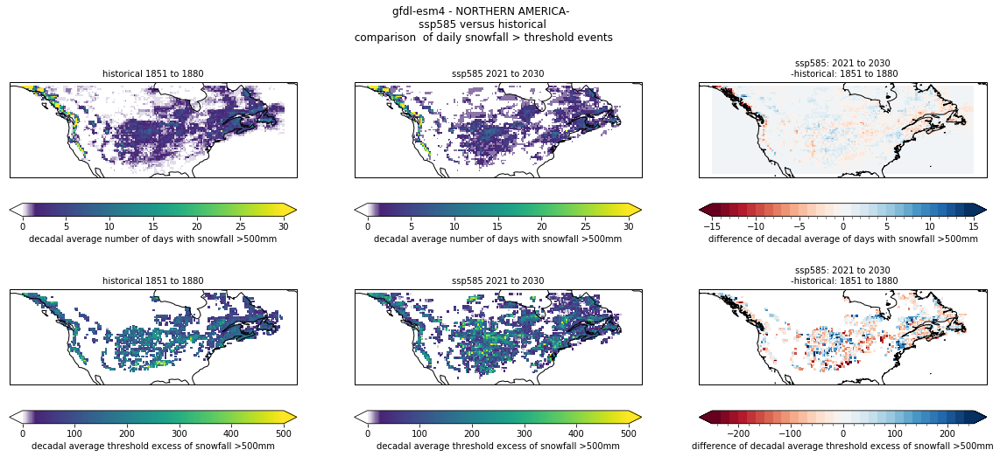

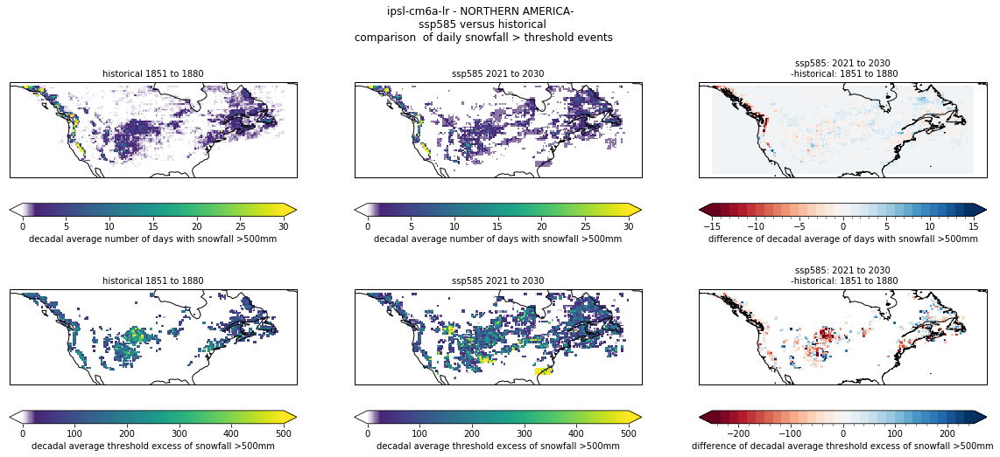

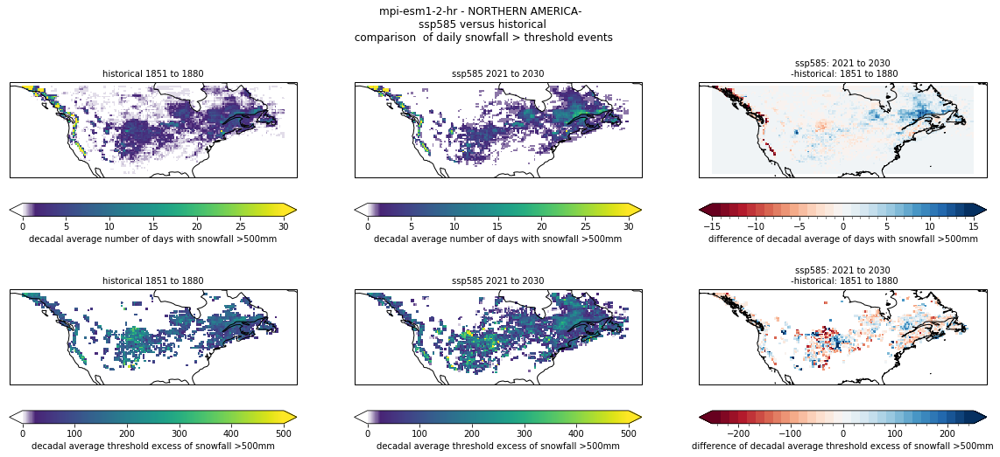

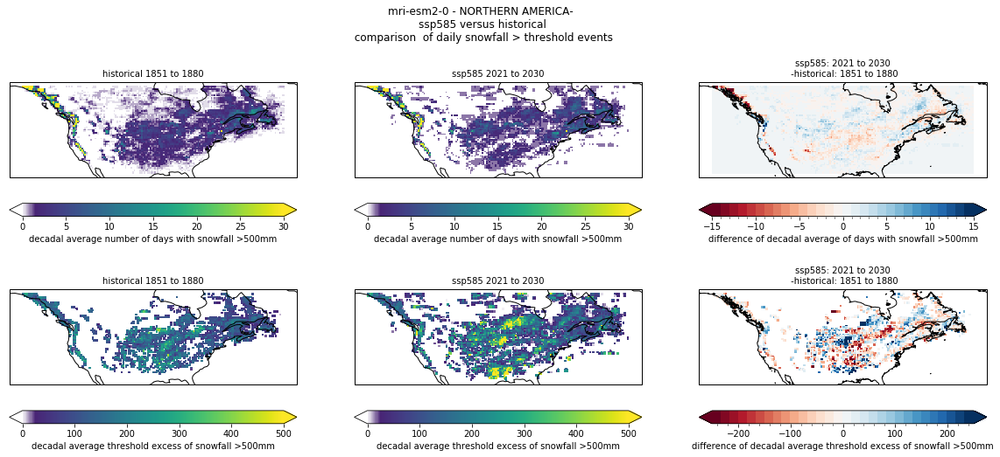

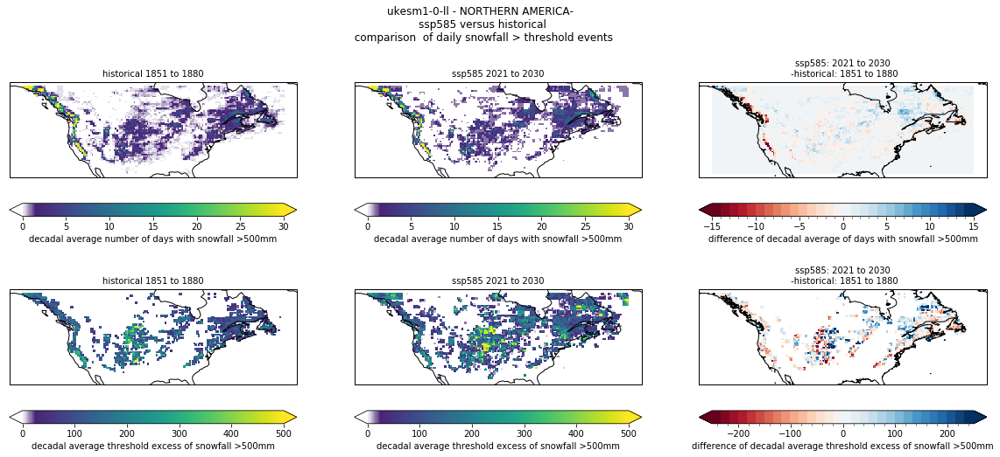

...

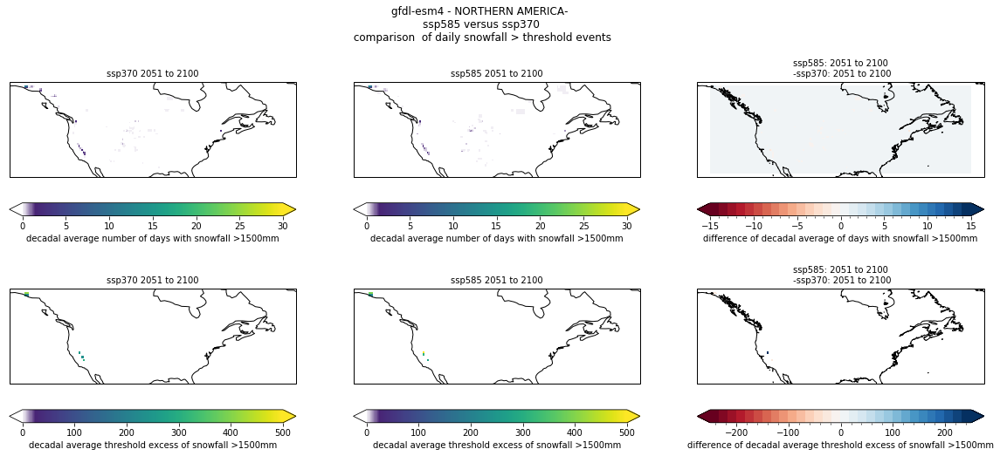

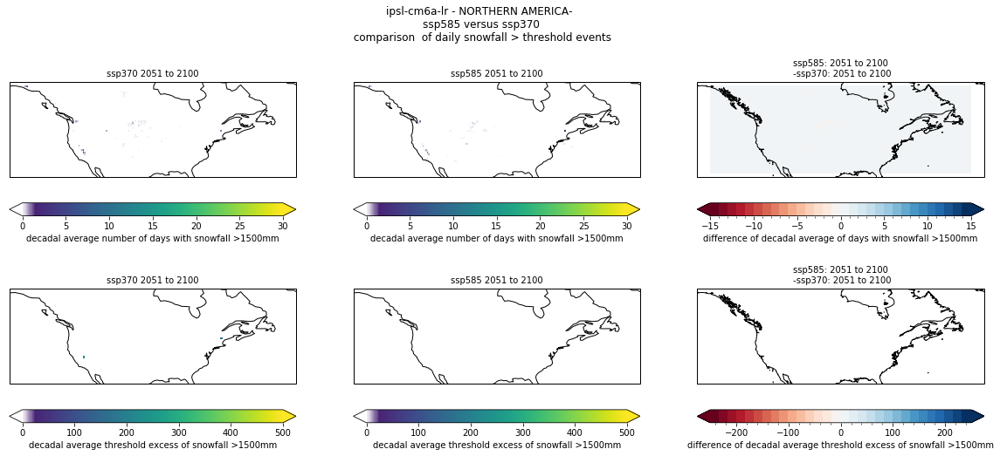

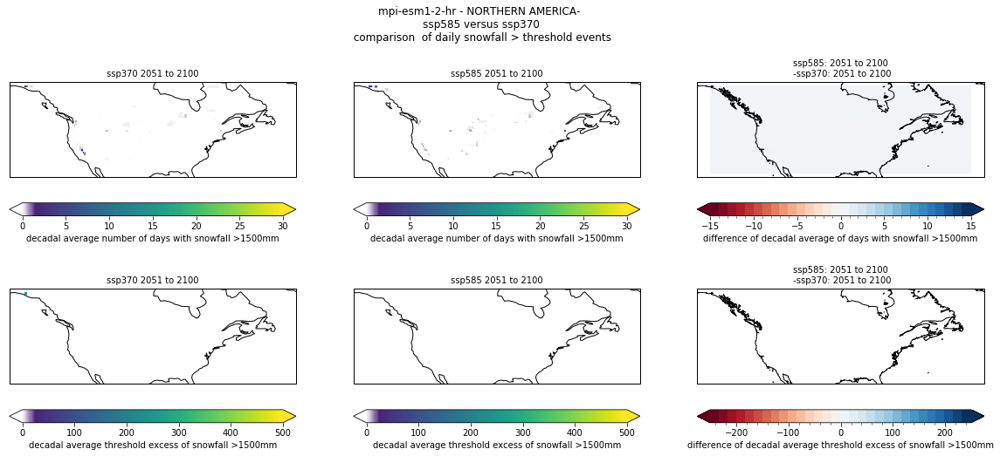

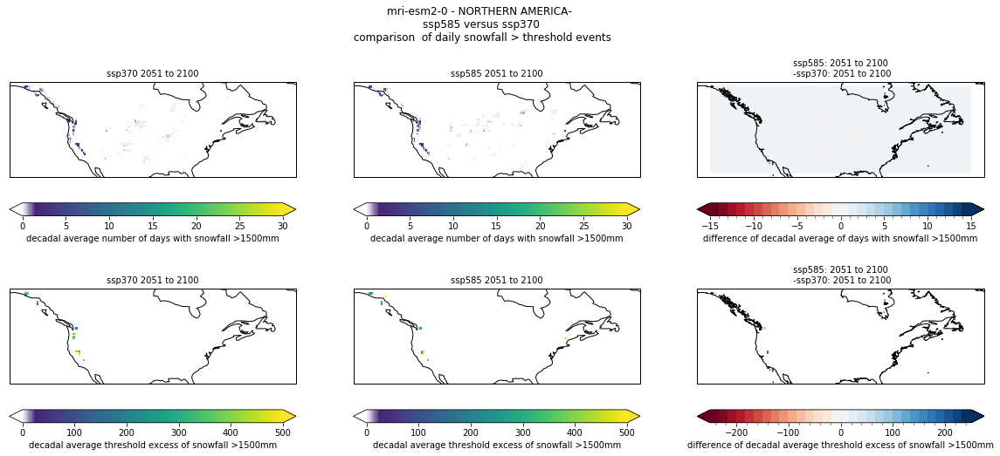

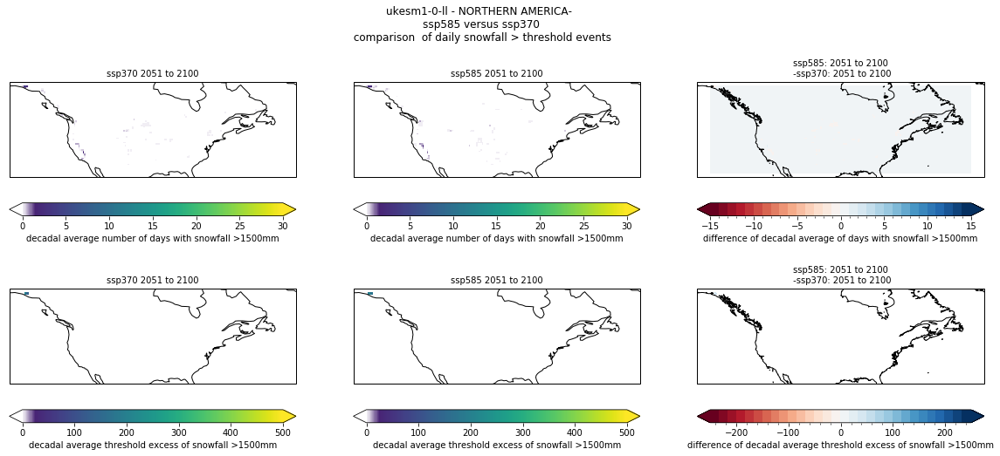

In [163]:
test = ensemble_simulation_maps (modellist,all_results,'preindustrial','NORTHERN AMERICA')

In [134]:

def ensemble_simulation (modellist,all_results,comparisonname,areaname):
    ensemble_results ={}
    for i_model in modellist:
        ensemble_results [i_model]=specify_results(all_results,i_model,comparisonname,areaname)

    ensemble = 'ISIMIP3b primary models'    
    # shortterm plots
    compare_timespans_threshold_frequency(modellist,ensemble_results,'ssp585',2021,2030,10,
            'historical',1851,1880,ensemble,areaname)
    compare_timespans_threshold_frequency(modellist,ensemble_results,'ssp585',2031,2040,10,
            'historical',1851,1880,ensemble,areaname)
    compare_timespans_threshold_frequency(modellist,ensemble_results,'ssp585',2041,2050,10,
            'historical',1851,1880,ensemble,areaname)   
    compare_timespans_threshold_frequency(modellist,ensemble_results,'ssp585',2021,2050,10,
            'historical',1851,1880,ensemble,areaname) 

    # longterm plots
    compare_timespans_threshold_frequency(modellist,ensemble_results,'ssp126',2051,2100,10,
            'historical',1851,1880,ensemble,areaname)
    compare_timespans_threshold_frequency(modellist,ensemble_results,'ssp370',2051,2100,10,
            'historical',1851,1880,ensemble,areaname)
    compare_timespans_threshold_frequency(modellist,ensemble_results,'ssp585',2051,2100,10,
            'historical',1851,1880,ensemble,areaname)
    compare_timespans_threshold_frequency(modellist,ensemble_results,'ssp585',2051,2100,10,
            'ssp126',2051,2100,ensemble,areaname)
    compare_timespans_threshold_frequency(modellist,ensemble_results,'ssp585',2051,2100,10,
            'ssp370',2051,2100,ensemble,areaname)



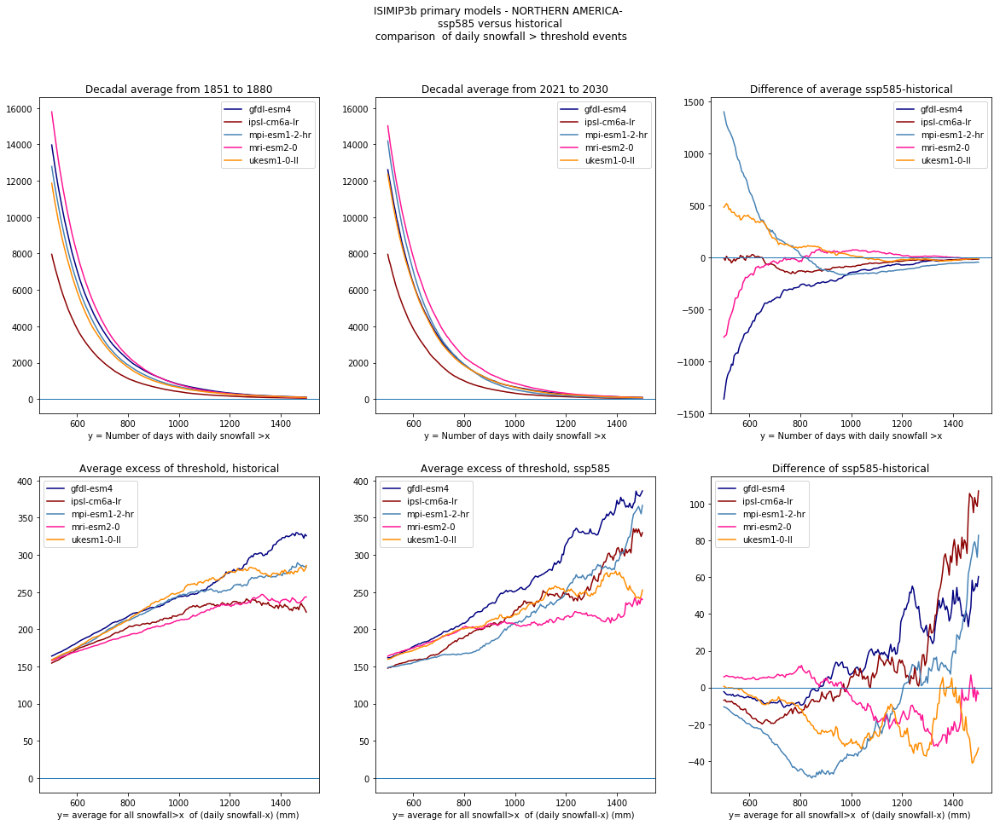

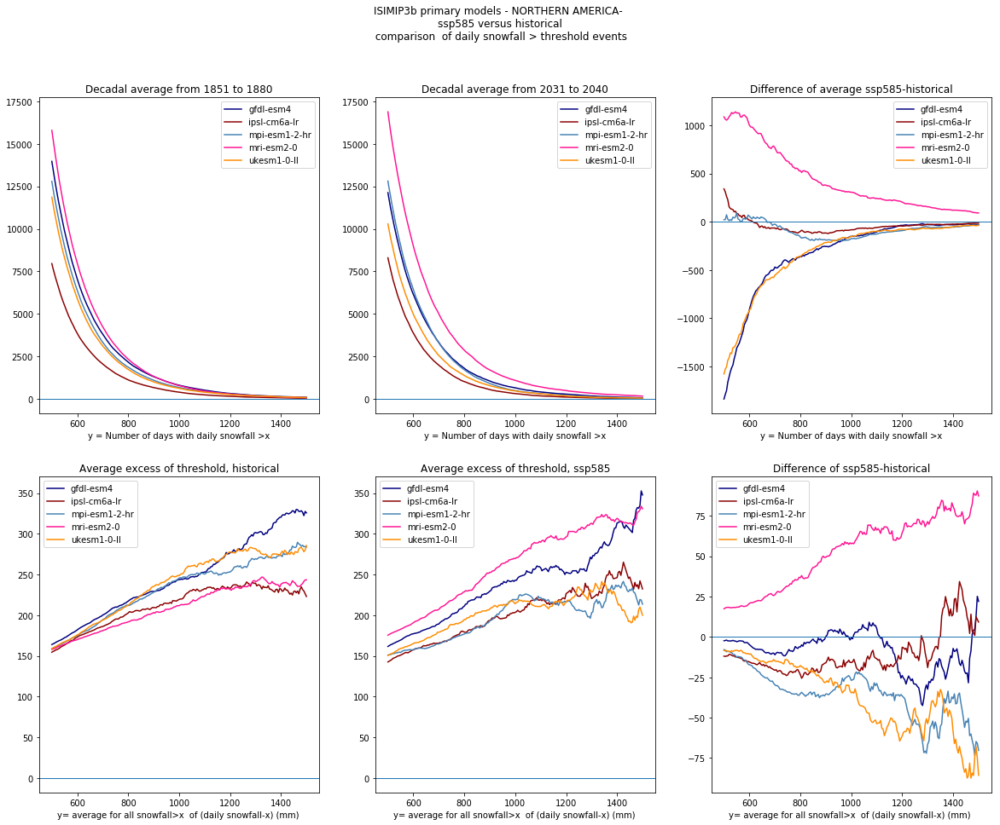

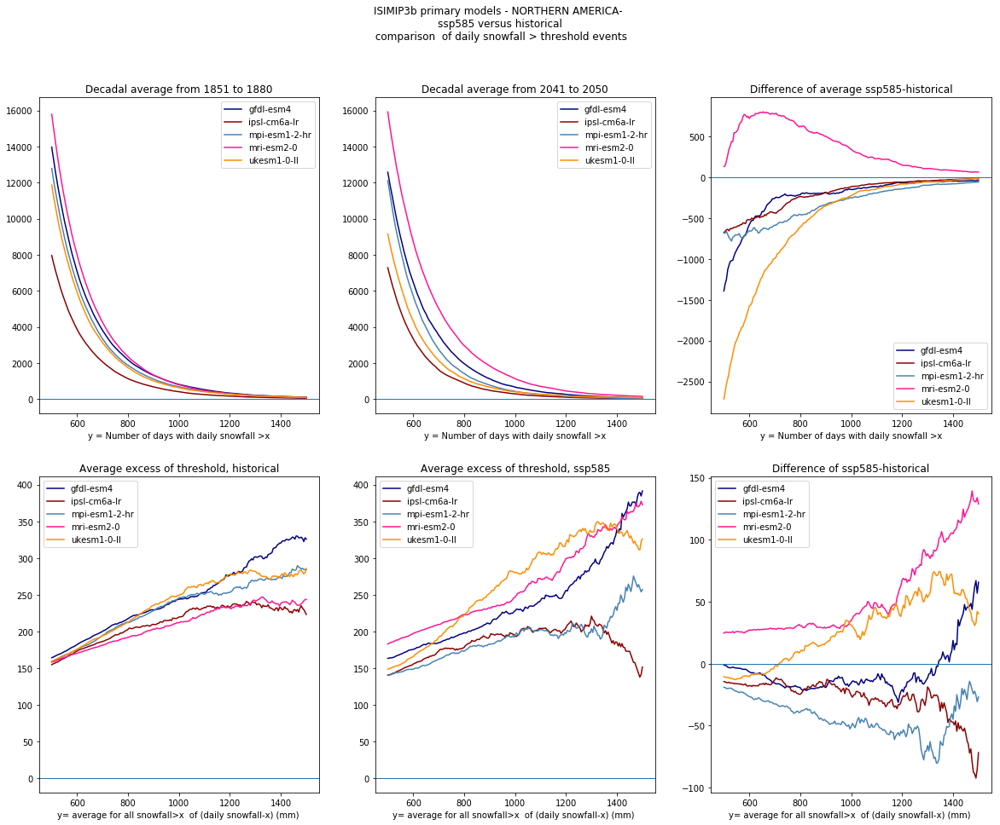

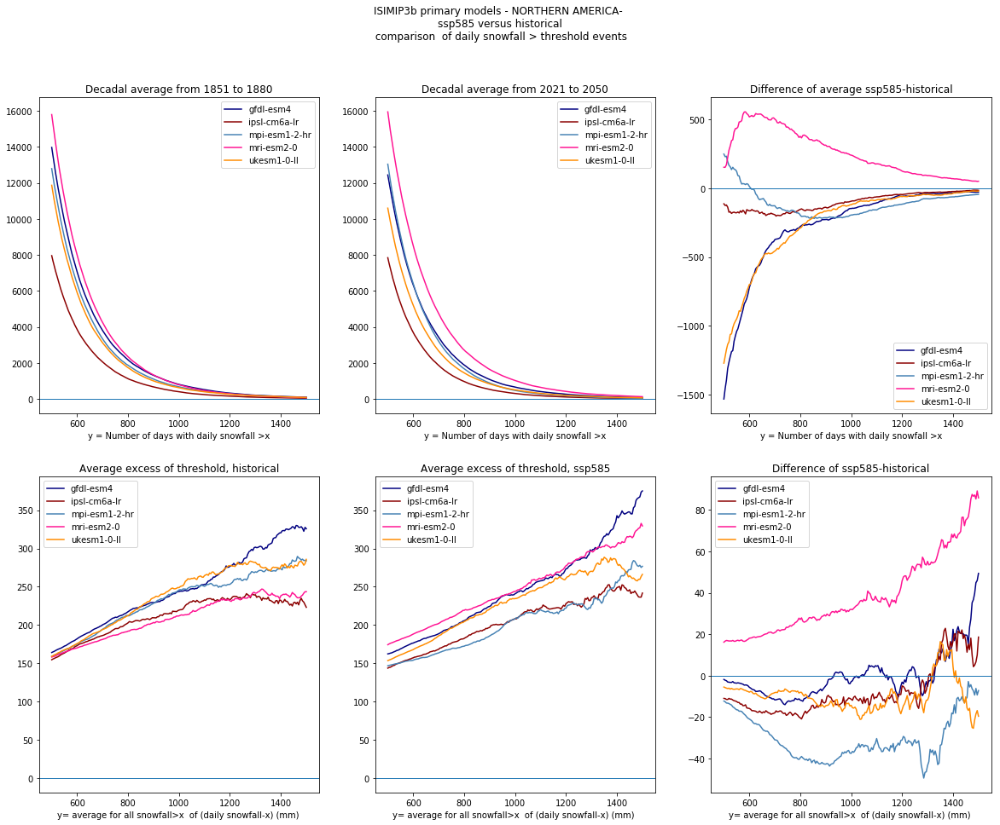

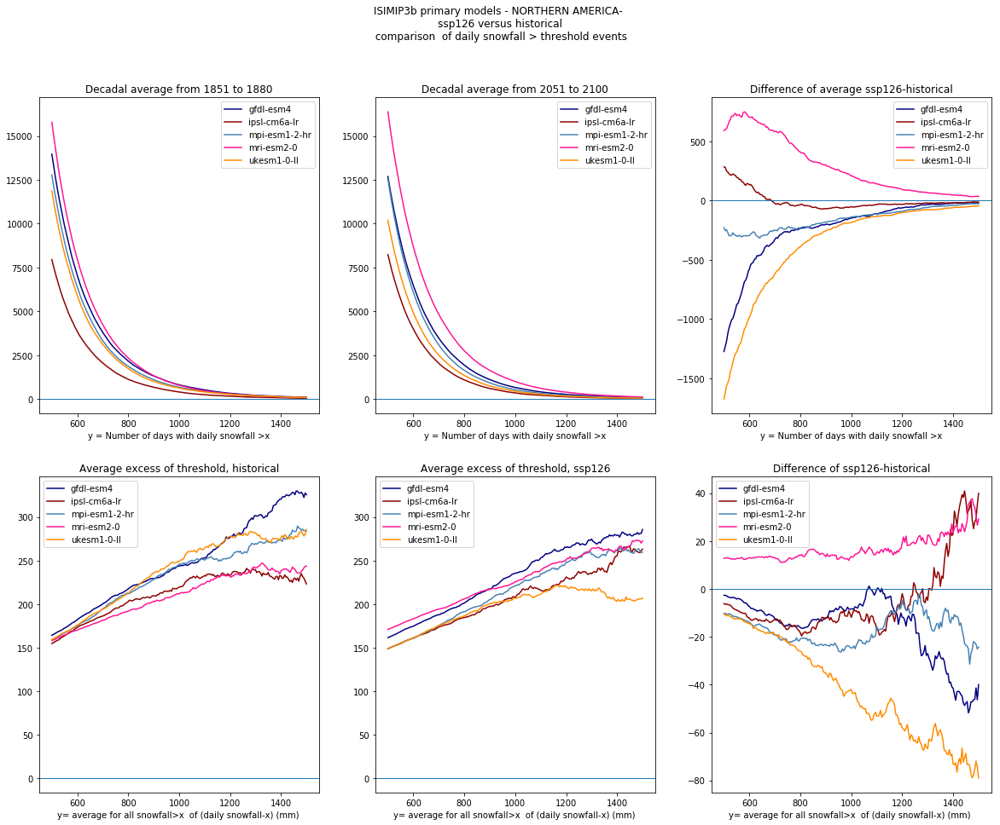

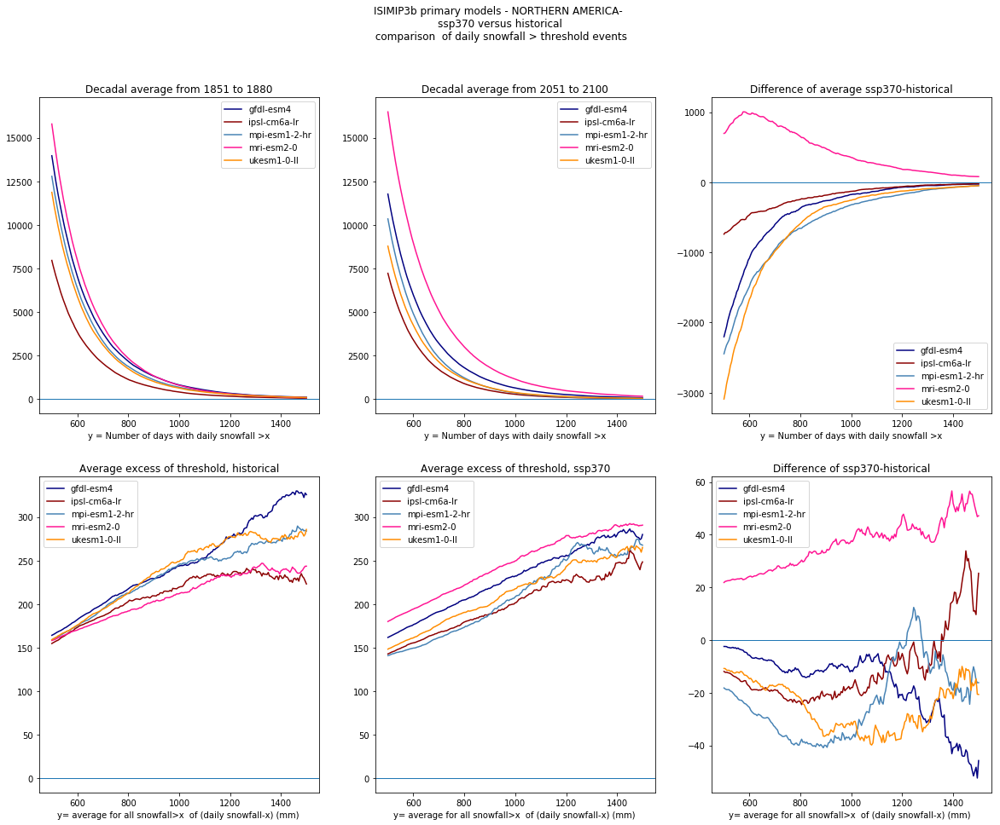

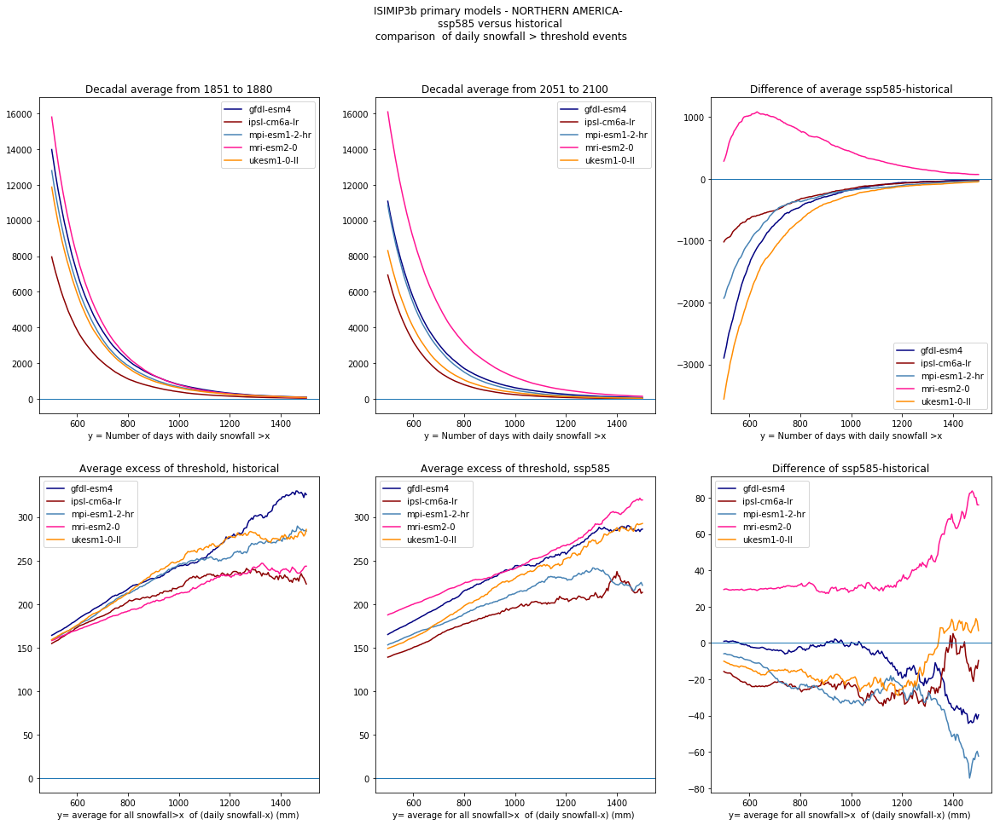

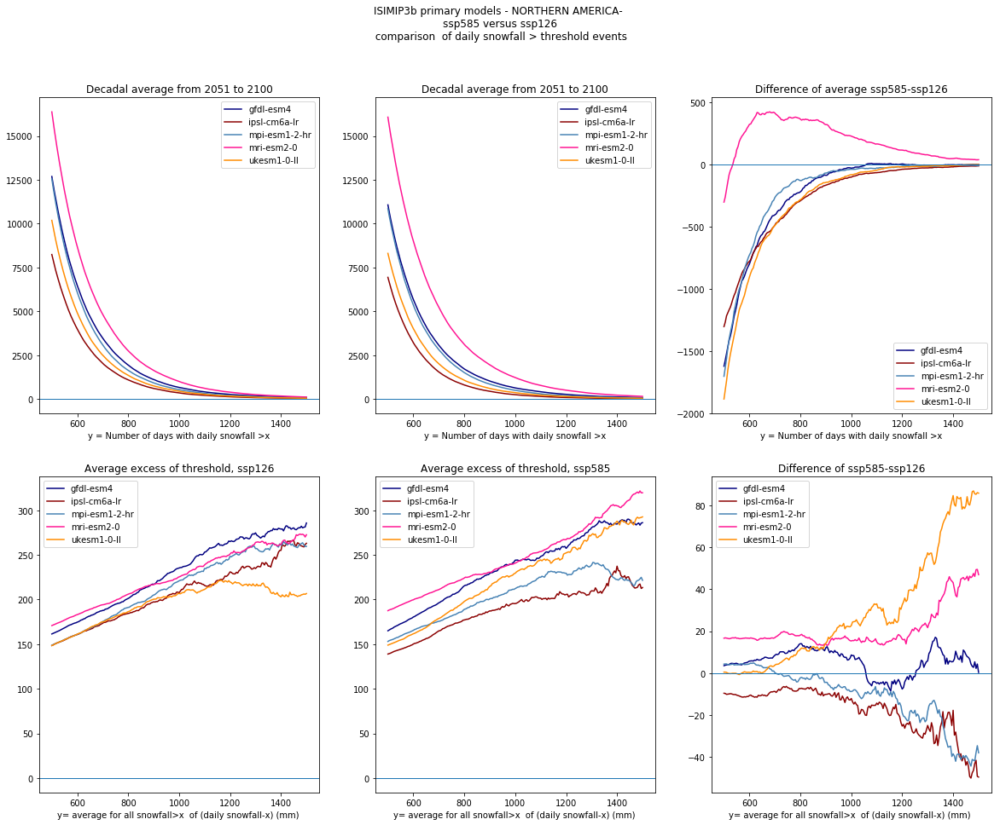

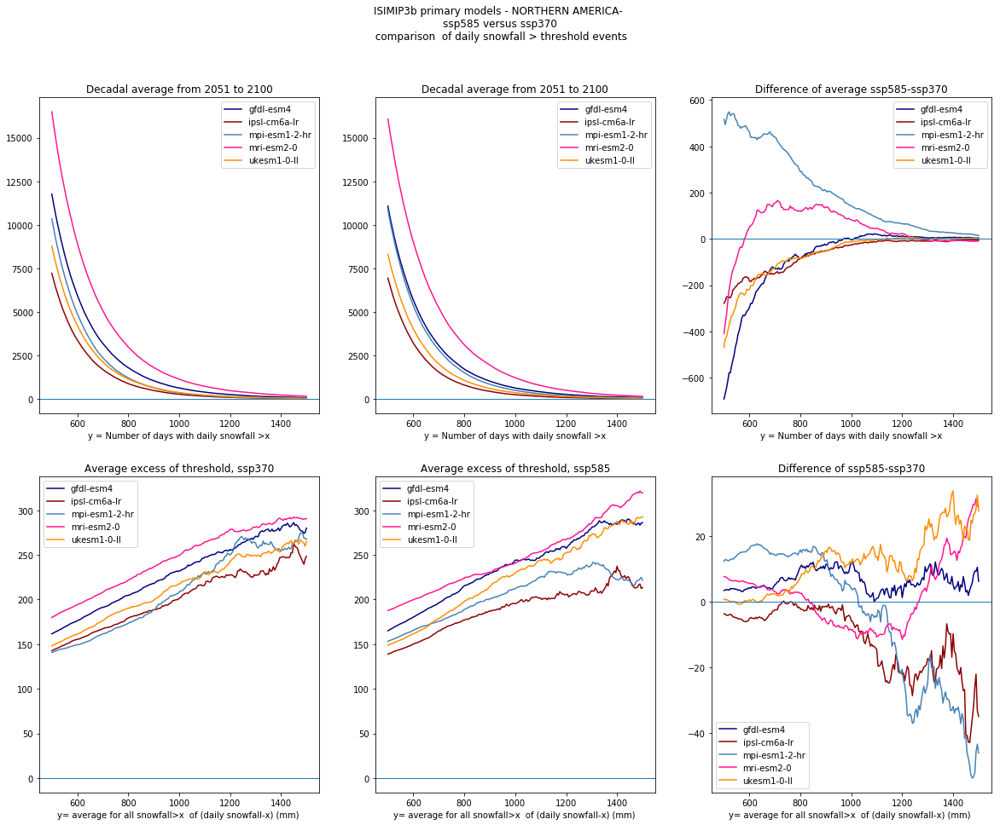

In [135]:
ensemble_simulation (modellist,all_results,'preindustrial','NORTHERN AMERICA')

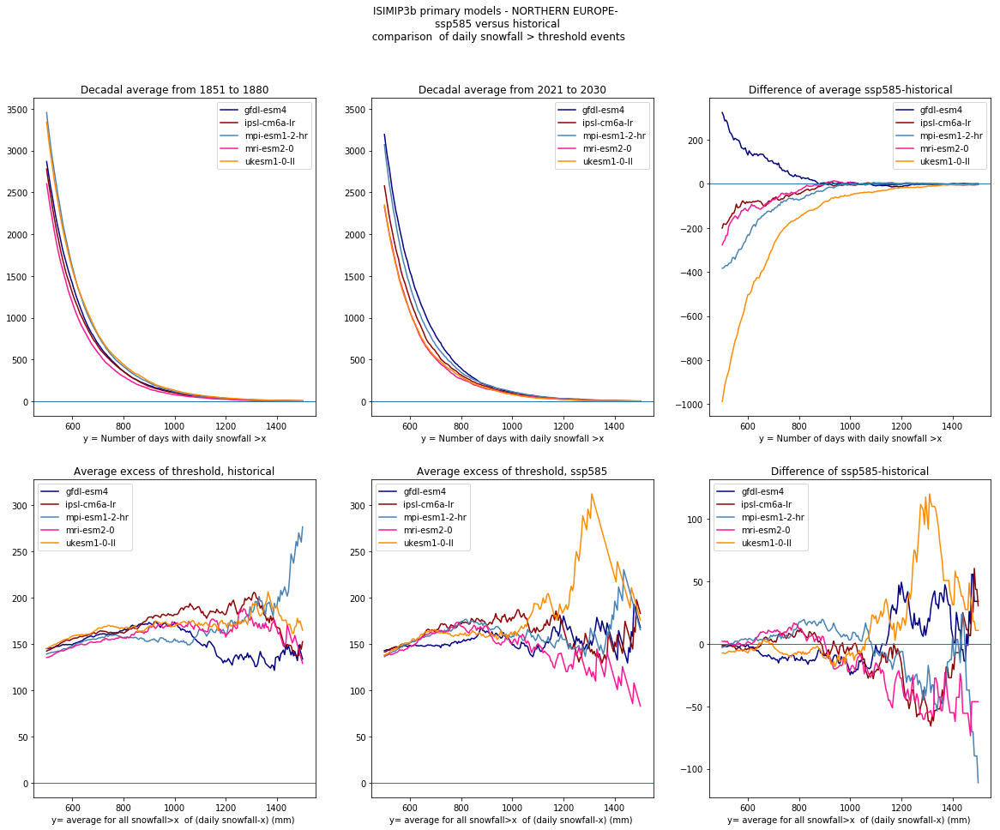

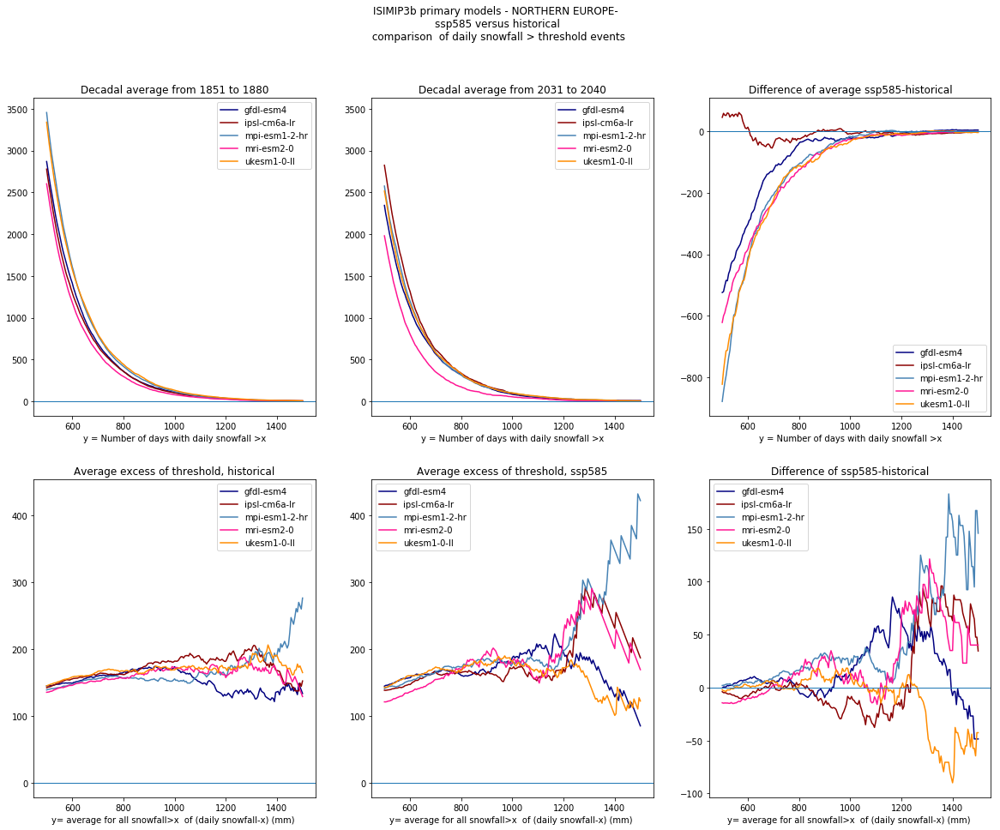

/home/quante/.conda/envs/my_root/lib/python3.6/site-packages/ipykernel_launcher.py:12: RuntimeWarning: invalid value encountered in true_divide
  if sys.path[0] == '':


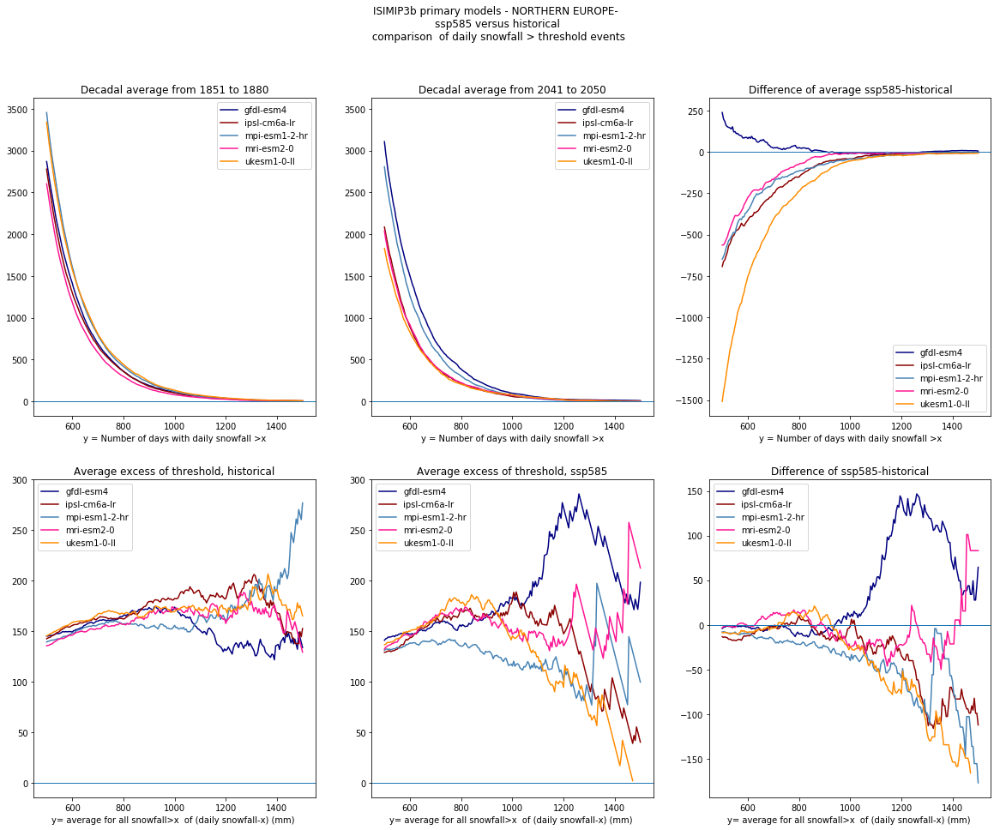

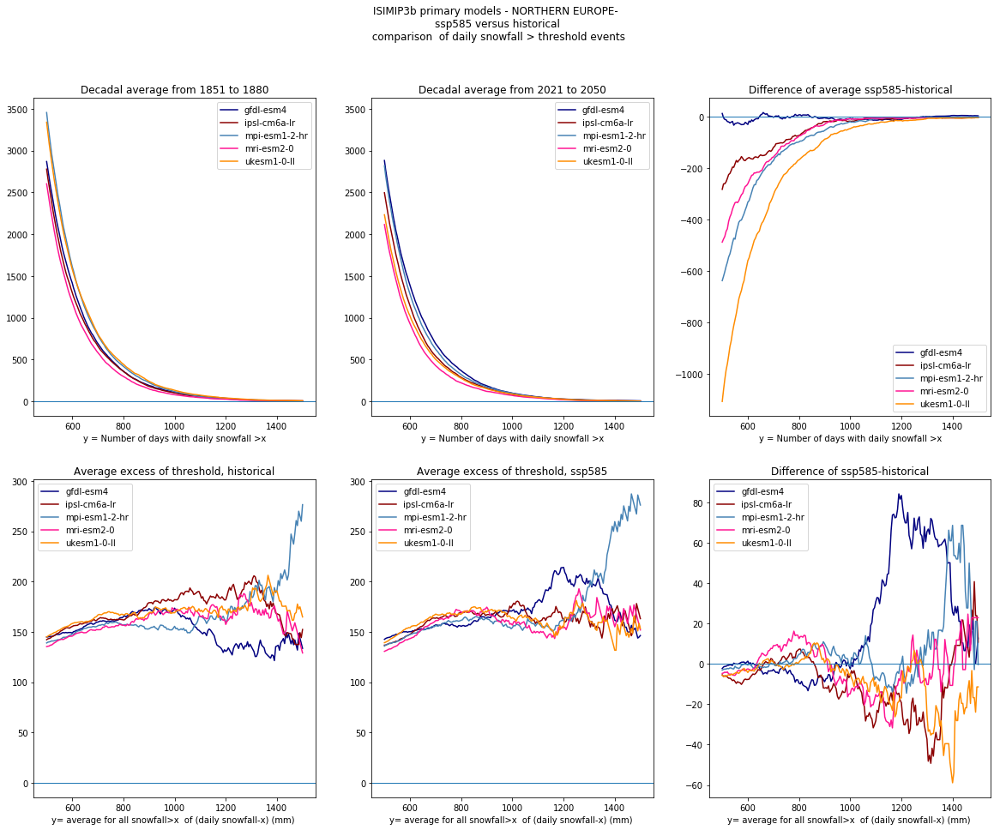

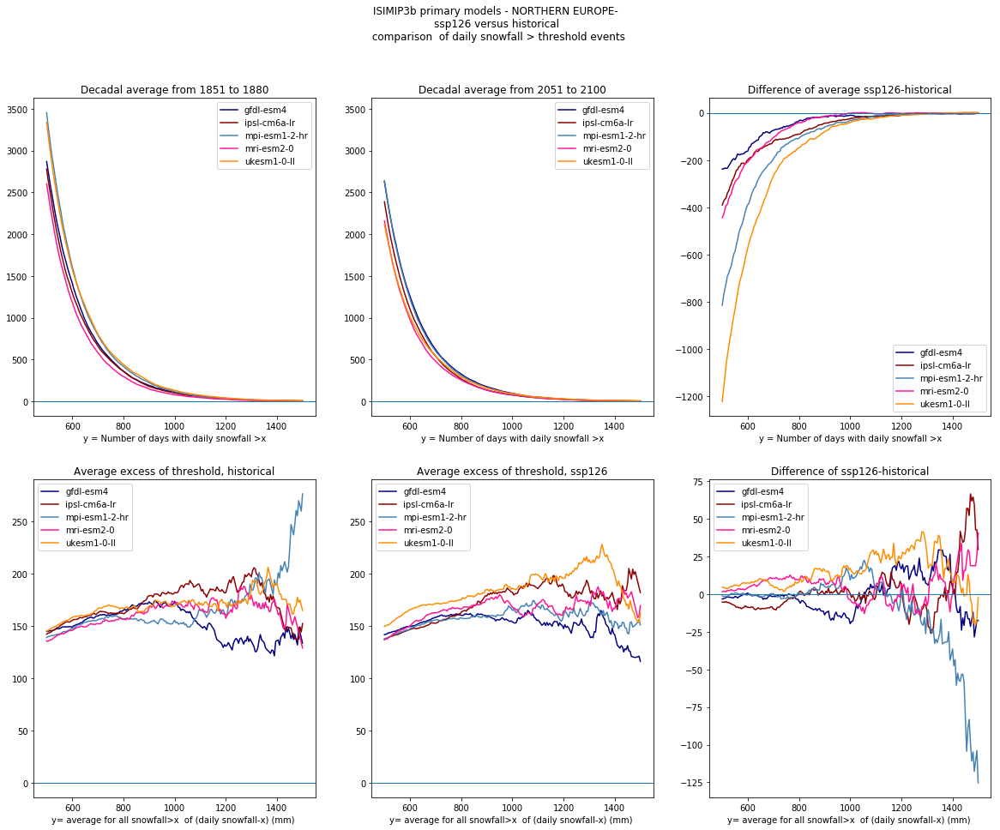

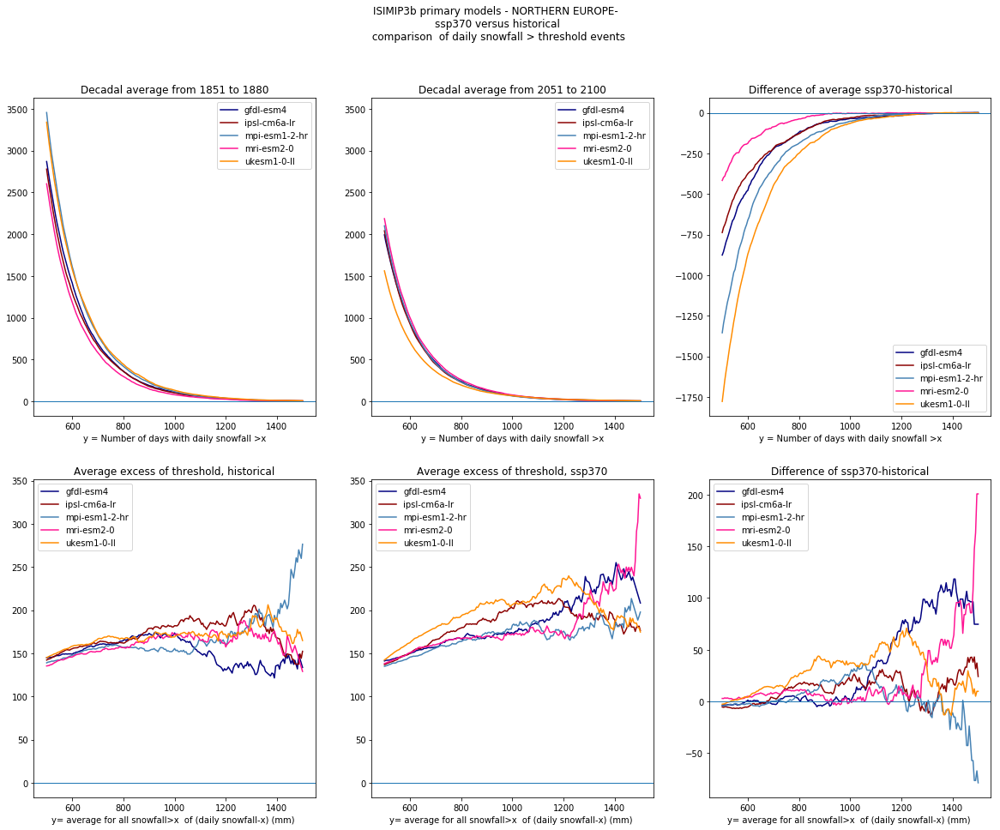

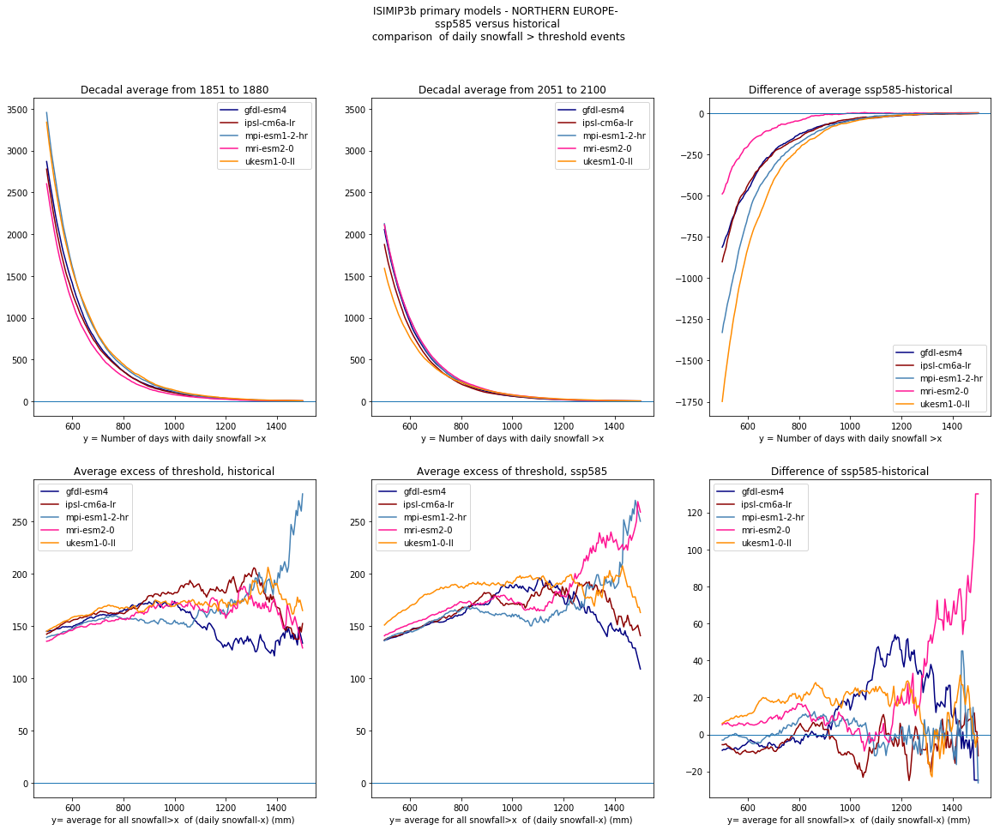

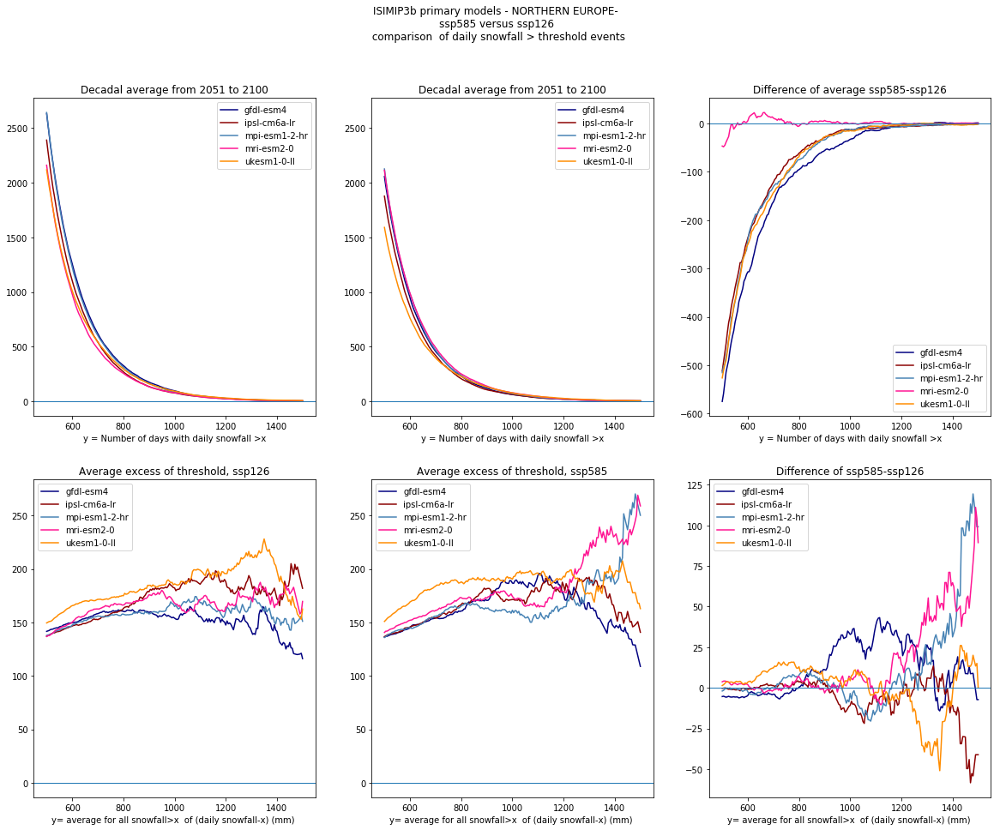

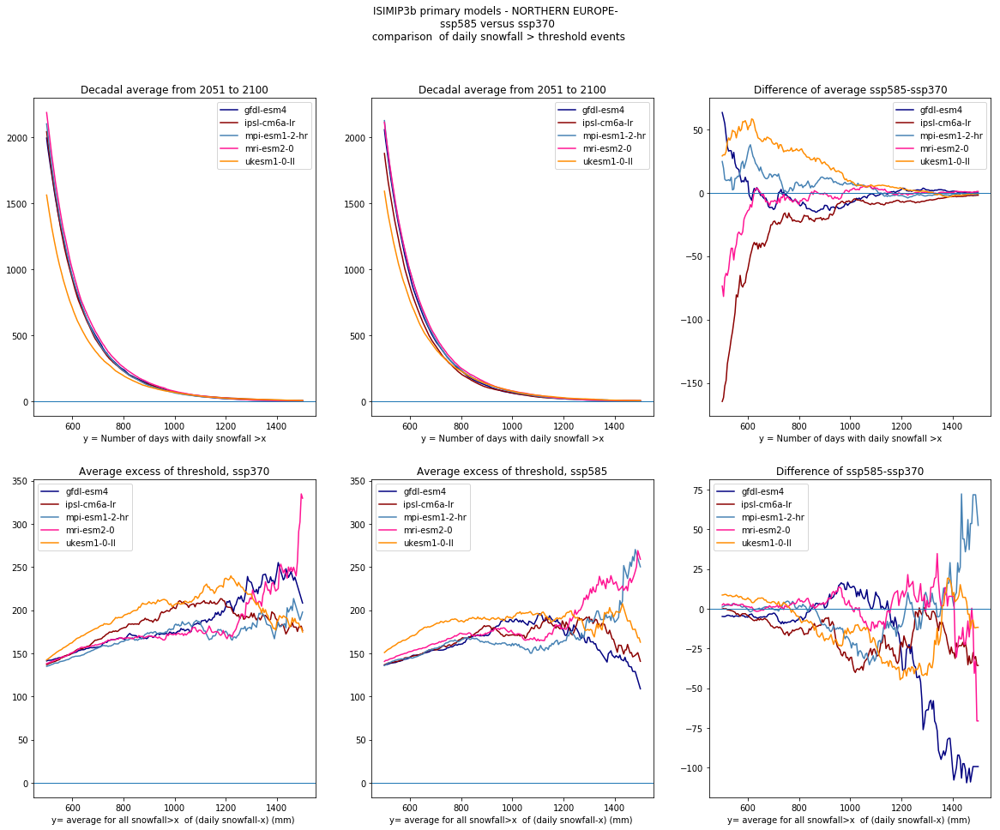

In [136]:
ensemble_simulation (modellist,all_results,'preindustrial','NORTHERN EUROPE')

/home/quante/.conda/envs/my_root/lib/python3.6/site-packages/iris/coords.py:1193: UserWarning: Coordinate 'longitude' is not bounded, guessing contiguous bounds.
  'contiguous bounds.'.format(self.name()))
/home/quante/.conda/envs/my_root/lib/python3.6/site-packages/iris/coords.py:1193: UserWarning: Coordinate 'latitude' is not bounded, guessing contiguous bounds.
  'contiguous bounds.'.format(self.name()))
/home/quante/.conda/envs/my_root/lib/python3.6/site-packages/matplotlib/tight_layout.py:211: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  warnings.warn('Tight layout not applied. '


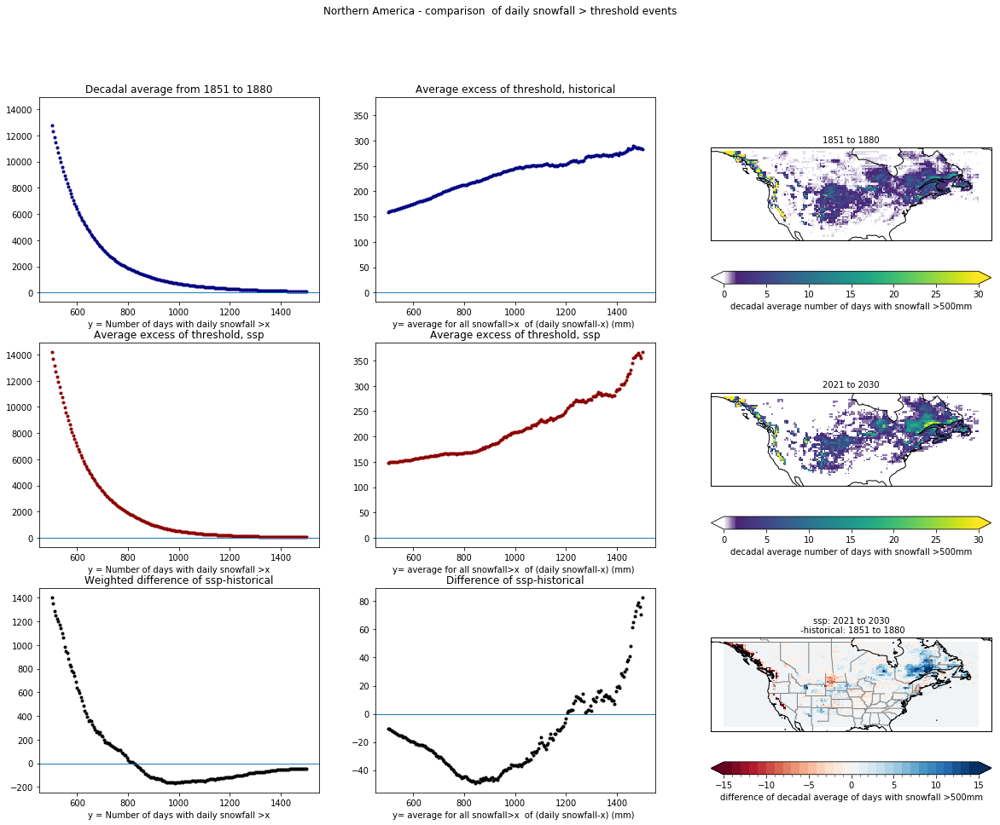

In [19]:

test = compare_timespans_threshold_frequency(specific_results,'ssp',2021,2030,10,
        'historical',1851,1880,10,'Northern America')
